In [3]:
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
import tools_preprocess_image
import tools_gmm
import tools_opti
from scipy.linalg import eig

# Example

In [13]:
from main import remove_rain_streaks
import matplotlib.pyplot as plt

B, R = remove_rain_streaks("data/case1.jpg", new_x=158*2//3, new_y=225*2//3, max_iter=20,
                           alpha=1e-8, beta=1e-9, gamma=1e-9)

100%|██████████| 20/20 [08:00<00:00, 24.01s/it]


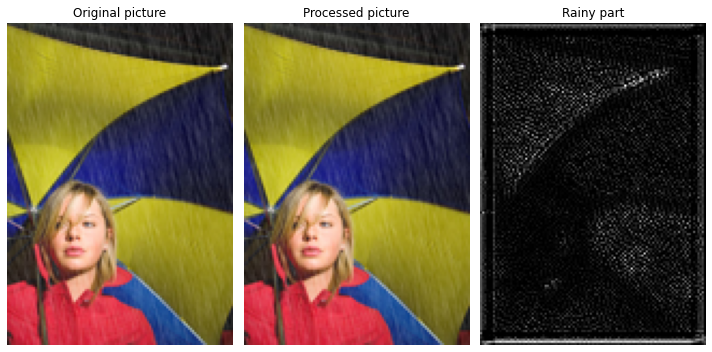

In [14]:
_, axs = plt.subplots(1, 3, figsize=(10, 5))
axs[0].imshow(B)
axs[0].set_title("Original picture")
axs[0].axis("off")

axs[1].imshow(B)
axs[1].set_title("Processed picture")
axs[1].axis("off")

axs[2].imshow(R, cmap = "gray")
axs[2].set_title("Rainy part")
axs[2].axis("off")

plt.tight_layout()
plt.show()

# Preprocess image

In [5]:
Y, Cr, Cb = tools_preprocess_image.preprocess_image("data/case1.jpg", new_x=158*2//3, new_y=225*2//3)

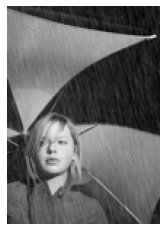

In [6]:
plt.imshow(Y, cmap = "gray")
plt.axis("off")
plt.show()

# GMM models

In [7]:
dim_b, nmodels_b, means_b, covs_b, invcovs_b, mixweights_b = tools_gmm.load_background_gmm('data/GSModel_8x8_200_2M_noDC_zeromean.mat')
b_gmm = tools_gmm.init_gmm(nmodels_b, means_b, covs_b, invcovs_b, mixweights_b)

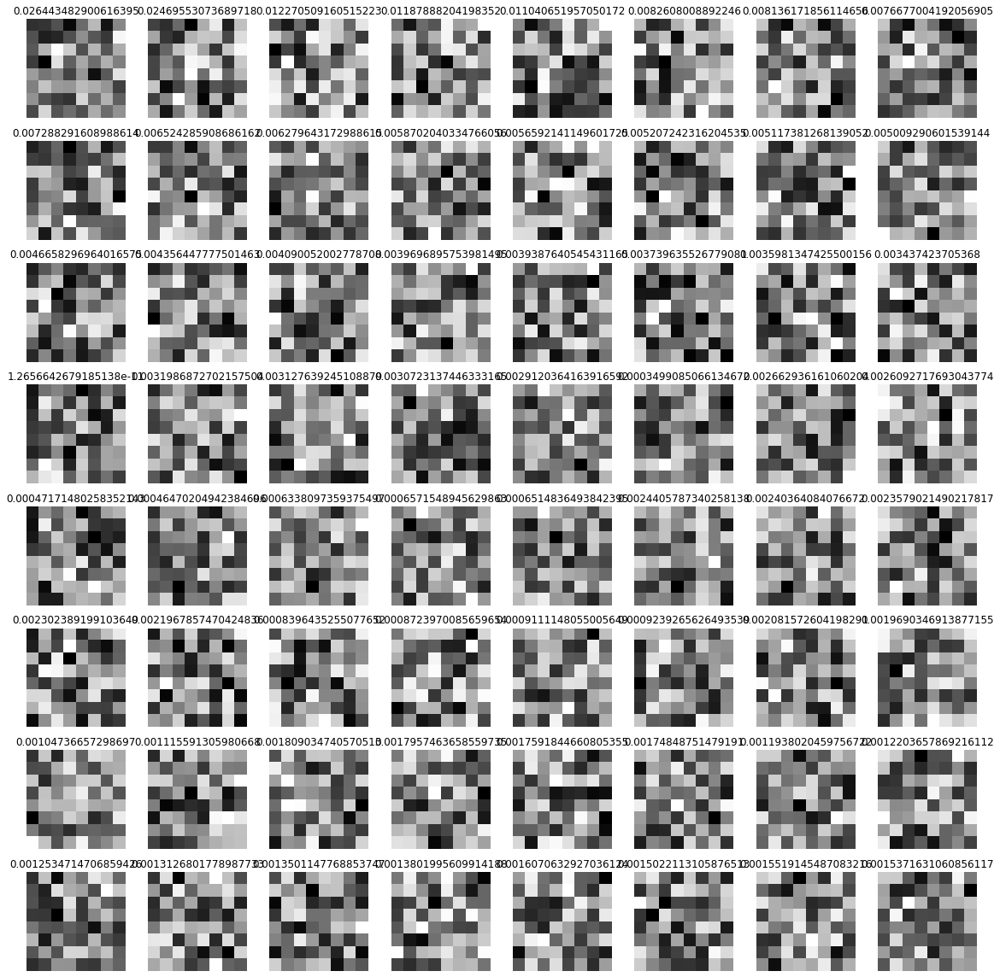

In [6]:
w, v = eig(covs_b.T[np.argmax(mixweights_b)])

_, axs = plt.subplots(8,8, figsize = (2*8, 2*8))
for i in range(8):
    for j in range(8):
        val, vector = w[8*i+j], v[8*i+j]
        axs[i,j].imshow(vector.reshape(8,8), cmap = "gray")
        axs[i,j].set_title(str(val.real))
        axs[i,j].axis("off")
plt.tight_layout()
plt.show()

In [8]:
(r_gmm, dim_r, nmodels_r, means_r, covs_r, invcovs_r, mixweights_r), region = tools_gmm.fit_rain_gmm(Y, region_size=(50, 50))

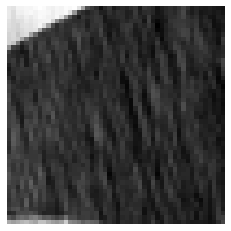

In [9]:
#Plot the image on with the gmm is trained
plt.imshow(region, cmap= "gray")
plt.axis("off")
plt.show()

## Plot eigenvectors of some rain gmm's covariance matrices

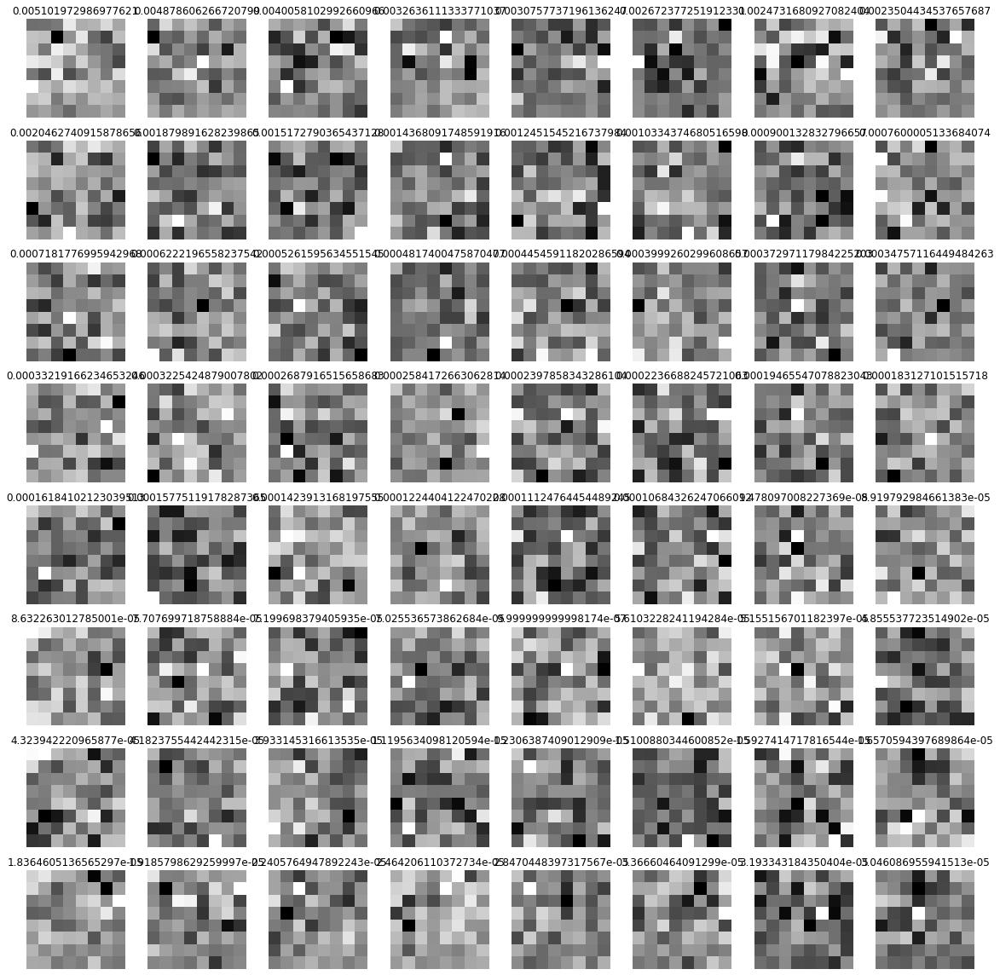

In [9]:
w, v = eig(covs_r.T[np.argmax(mixweights_r)])

_, axs = plt.subplots(8,8, figsize = (2*8, 2*8))
for i in range(8):
    for j in range(8):
        val, vector = w[8*i+j], v[8*i+j]
        axs[i,j].imshow(vector.reshape(8,8), cmap = "gray")
        axs[i,j].set_title(str(val.real))
        axs[i,j].axis("off")
plt.tight_layout()
plt.show()

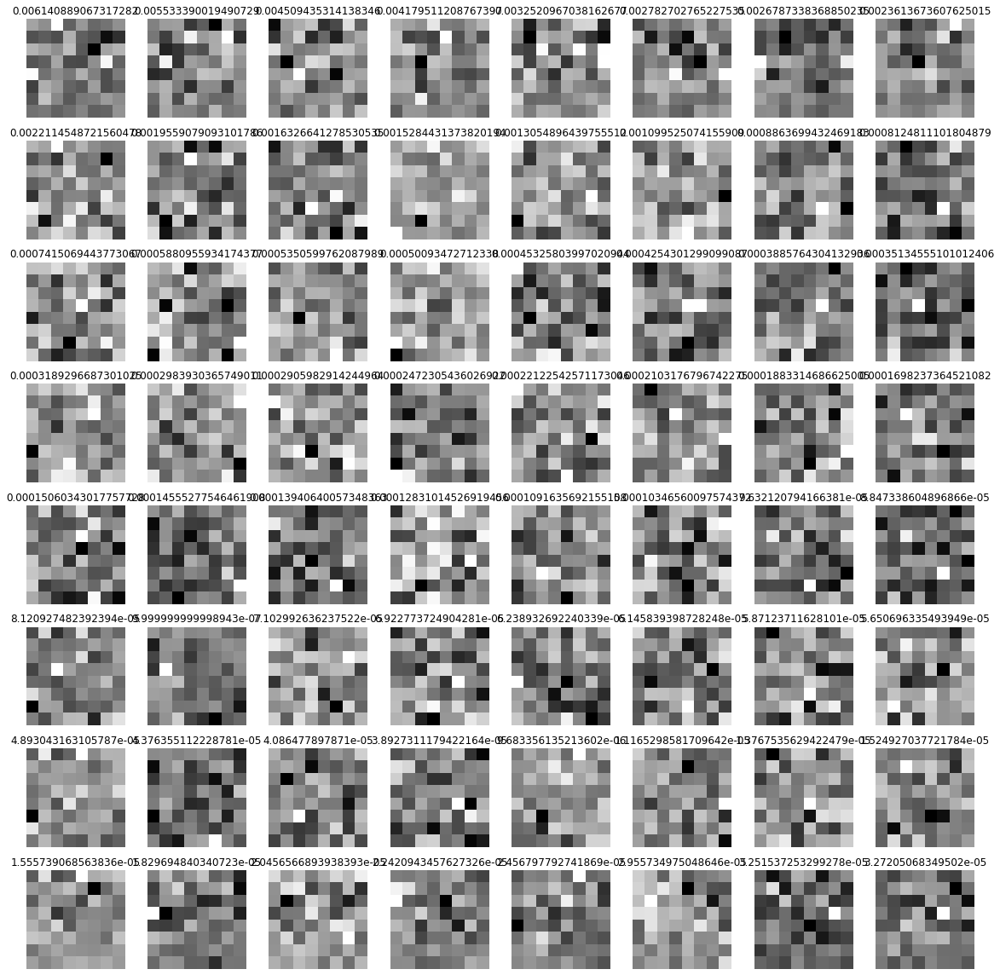

In [10]:
w, v = eig(covs_r.T[0])

_, axs = plt.subplots(8,8, figsize = (2*8, 2*8))
for i in range(8):
    for j in range(8):
        val, vector = w[8*i+j], v[8*i+j]
        axs[i,j].imshow(vector.reshape(8,8), cmap = "gray")
        axs[i,j].set_title(str(val.real))
        axs[i,j].axis("off")
plt.tight_layout()
plt.show()

# Test each step of optimization

## First problem: update H

In [18]:
B = Y.copy()
alpha, omega = 0, 1
H = tools_opti.update_H(B, alpha/(2*omega))

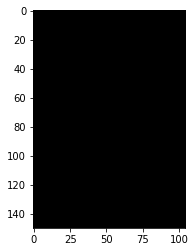

In [19]:
plt.imshow((tools_opti.gradient(B) - H)[:,:,0], cmap = "gray")
plt.imshow((tools_opti.gradient(B) - H)[:,:,1], cmap = "gray")

## Problem 2: update B and R

In [13]:
minim = tools_opti.update_BR(Y, Y.flatten(), Y.flatten(), tools_opti.Ps(Y), tools_opti.Ps(Y), tools_opti.gradient(Y),1,0.1)

In [15]:
B = minim[0]
R = minim[1]

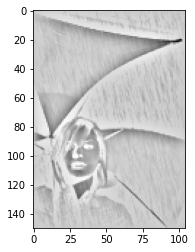

In [16]:
plt.imshow(Y -(B+R), cmap = "gray")

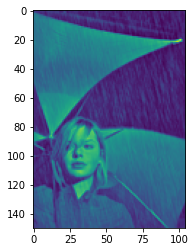

In [17]:
plt.imshow(B+R)

## Problème 3: udpate g

In [11]:
tools_opti.update_g(Y, r_gmm, 1, 1).shape

(143, 98, 8, 8)

In [12]:
tools_opti.update_g(Y, b_gmm, 1, 1)

array([[[[-4.92583367e-02, -8.63729979e-02, -1.24914685e-01, ...,
          -1.61499845e-01, -1.58922206e-01, -1.56533907e-01],
         [ 2.99318466e-02, -1.59712823e-03, -4.92599975e-02, ...,
          -1.64668299e-01, -1.63060224e-01, -1.60206483e-01],
         [ 6.42152184e-02,  6.11275911e-02,  4.36013836e-02, ...,
          -1.16555409e-01, -1.46494065e-01, -1.54925178e-01],
         ...,
         [ 6.83228002e-02,  6.75404035e-02,  6.68155130e-02, ...,
           6.52937863e-02,  6.24572202e-02,  4.52671404e-02],
         [ 6.88538384e-02,  6.88501774e-02,  6.87325009e-02, ...,
           6.58618154e-02,  6.53748938e-02,  6.30317426e-02],
         [ 6.96332746e-02,  7.00884436e-02,  6.98193241e-02, ...,
           6.76715319e-02,  6.65849069e-02,  6.52621490e-02]],

        [[-8.93594880e-02, -9.70107904e-02, -1.02782011e-01, ...,
          -1.09751912e-01, -1.08437286e-01, -1.05042195e-01],
         [-8.24577057e-02, -9.19575046e-02, -9.97762231e-02, ...,
          -1.10615269e

# Hyperparameters tuning

### First round

Nous avons testé l'optimisation sur ces paramètres : 

beta_list = [1e-9, 1e-8, 1e-7, 1e-6 ,1e-5]\
alpha_list = [1e-8, 1e-7, 1e-6 ,1e-5, 1e-4]\
gamma_list = [1e-11, 1e-9, 1e-7, 1e-6, 1e-5]

Pour alpha > 1e-5, les contours commencent à être déctectés de manière de plus en plus marquée quand alpha augmente. <b>alpha = 1e-4 est clairement trop grand.</b>

<b>Les valeurs de beta n'influent pas sur le résultat. Les valeurs choisies ne sont peut-être pas dans une fenêtre pertinente.</b>

Pour gamma > 1e-7 l'image R n'est plus qu'un dégradé sans aucune forme apparente. Les grandes lignes de l'image apparaissent dans R pour g = 1e-11 et g = 1e-9. Pour g = 1e-9, celles-ci sont plus marquées et des petits points apparaissent. En fond, il semble qu'il y ait quelques traînées de pluie. Ces points et ces traînées ne sont pas présents pour g = 1e-11. <b>Il faut sans doute choisir g entre 1e-11 et 1e-7.</b>

In [47]:
beta_list = [1e-9, 1e-8, 1e-7, 1e-6 ,1e-5]
alpha_list = [1e-8, 1e-7, 1e-6 ,1e-5, 1e-4]
gamma_list = [1e-11, 1e-9, 1e-7, 1e-6, 1e-5]

test_list = [(b, a, g) for b in beta_list for a in alpha_list for g in gamma_list]
pictures = []
for b, a, g in tqdm(test_list):
    B, R, gB, gR = opti(Y,
                    r_gmm = r_gmm, b_gmm = b_gmm,
                    alpha = a, beta = b, gamma = g, 
                    omega0 = 1,
                    max_iter = 5)
    
    pictures.append((b,a,g,B,R))

100%|██████████| 125/125 [7:07:20<00:00, 205.13s/it]


In [78]:
dico_pictures = {}
for b, a, g, B, R in pictures:
    dico_pictures[(b,a,g)] = B, R

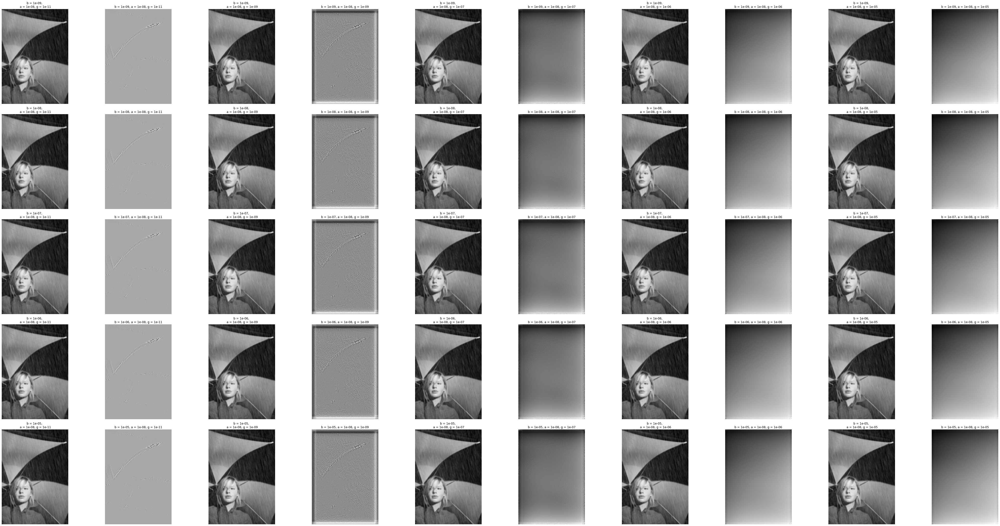

In [63]:
_, axs = plt.subplots(5,10, figsize = (60, 30))

i = -1
for b, a, g, B, R in pictures:
    if a == 1e-8:
        i += 1
        axs[i//5, i%5*2].imshow(B, cmap = "gray")
        axs[i//5, i%5*2 + 1].imshow(R, cmap = "gray")
        axs[i//5, i%5*2].axis("off")
        axs[i//5, i%5*2 + 1].axis("off")
        axs[i//5, i%5*2].set_title(f"b = {b}, \n a = {a}, g = {g}")
        axs[i//5, i%5*2 + 1].set_title(f"b = {b}, a = {a}, g = {g}") 

plt.tight_layout()     

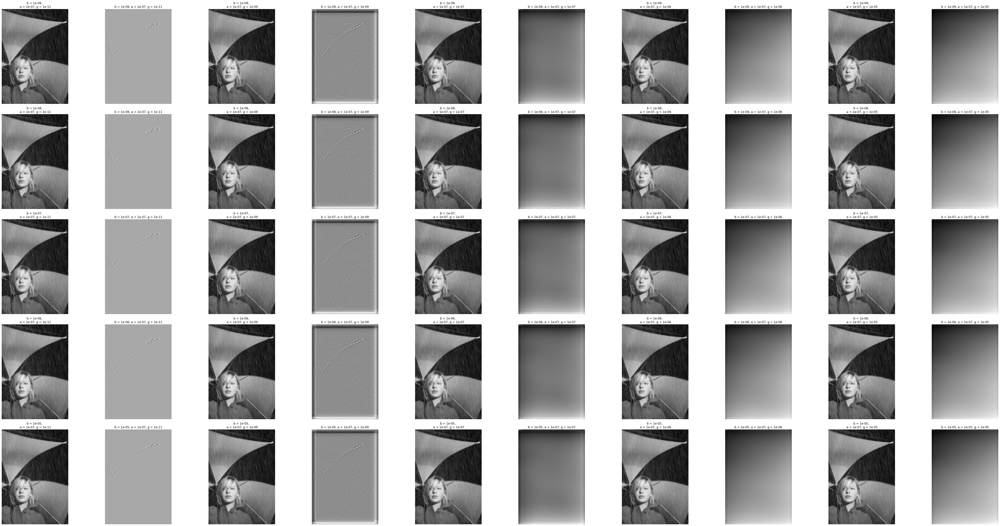

In [105]:
_, axs = plt.subplots(5,10, figsize = (60, 30))

i = -1
for b, a, g, B, R in pictures:
    if a == 1e-7:
        i += 1
        axs[i//5, i%5*2].imshow(B, cmap = "gray")
        axs[i//5, i%5*2 + 1].imshow(R, cmap = "gray")
        axs[i//5, i%5*2].axis("off")
        axs[i//5, i%5*2 + 1].axis("off")
        axs[i//5, i%5*2].set_title(f"b = {b}, \n a = {a}, g = {g}")
        axs[i//5, i%5*2 + 1].set_title(f"b = {b}, a = {a}, g = {g}") 

plt.tight_layout()    

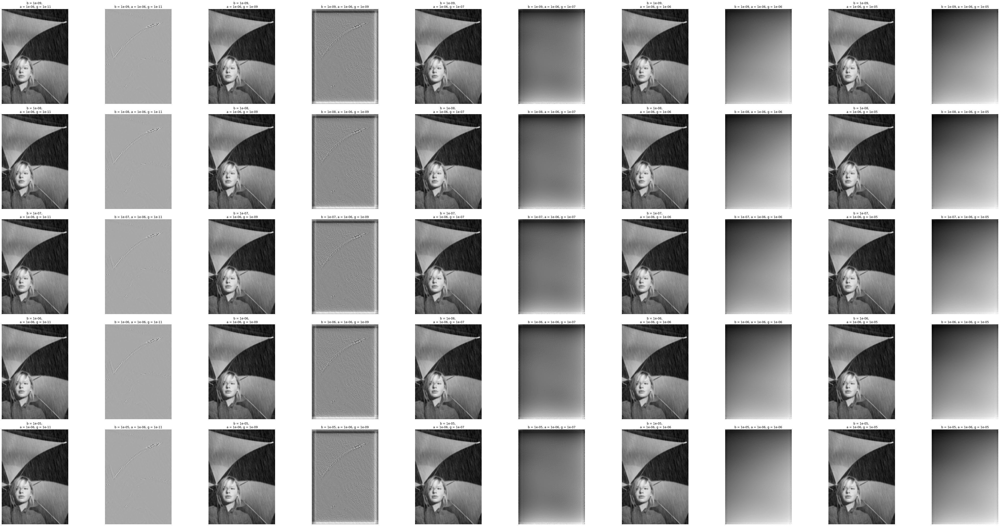

In [106]:
_, axs = plt.subplots(5,10, figsize = (60, 30))

i = -1
for b, a, g, B, R in pictures:
    if a == 1e-6:
        i += 1
        axs[i//5, i%5*2].imshow(B, cmap = "gray")
        axs[i//5, i%5*2 + 1].imshow(R, cmap = "gray")
        axs[i//5, i%5*2].axis("off")
        axs[i//5, i%5*2 + 1].axis("off")
        axs[i//5, i%5*2].set_title(f"b = {b}, \n a = {a}, g = {g}")
        axs[i//5, i%5*2 + 1].set_title(f"b = {b}, a = {a}, g = {g}") 

plt.tight_layout()   

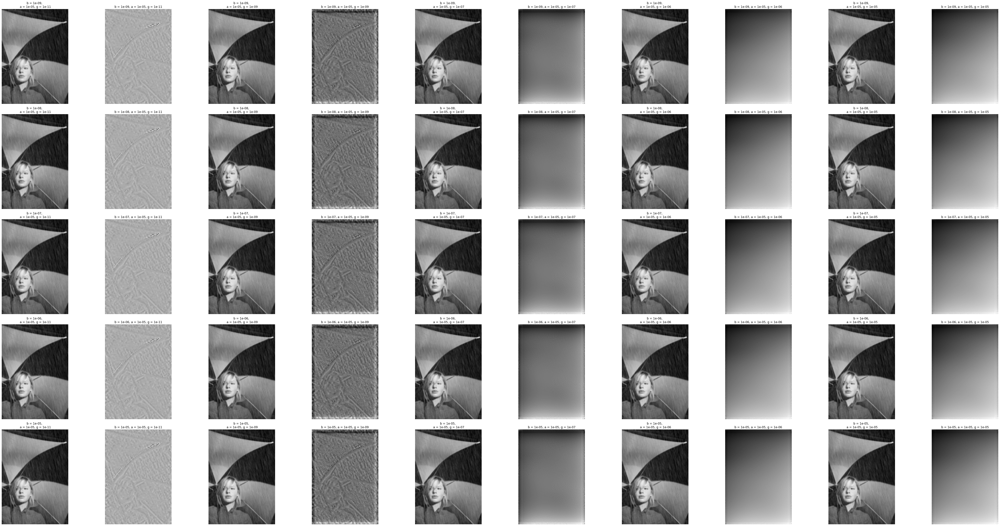

In [107]:
_, axs = plt.subplots(5,10, figsize = (60, 30))

i = -1
for b, a, g, B, R in pictures:
    if a == 1e-5:
        i += 1
        axs[i//5, i%5*2].imshow(B, cmap = "gray")
        axs[i//5, i%5*2 + 1].imshow(R, cmap = "gray")
        axs[i//5, i%5*2].axis("off")
        axs[i//5, i%5*2 + 1].axis("off")
        axs[i//5, i%5*2].set_title(f"b = {b}, \n a = {a}, g = {g}")
        axs[i//5, i%5*2 + 1].set_title(f"b = {b}, a = {a}, g = {g}") 

plt.tight_layout()   

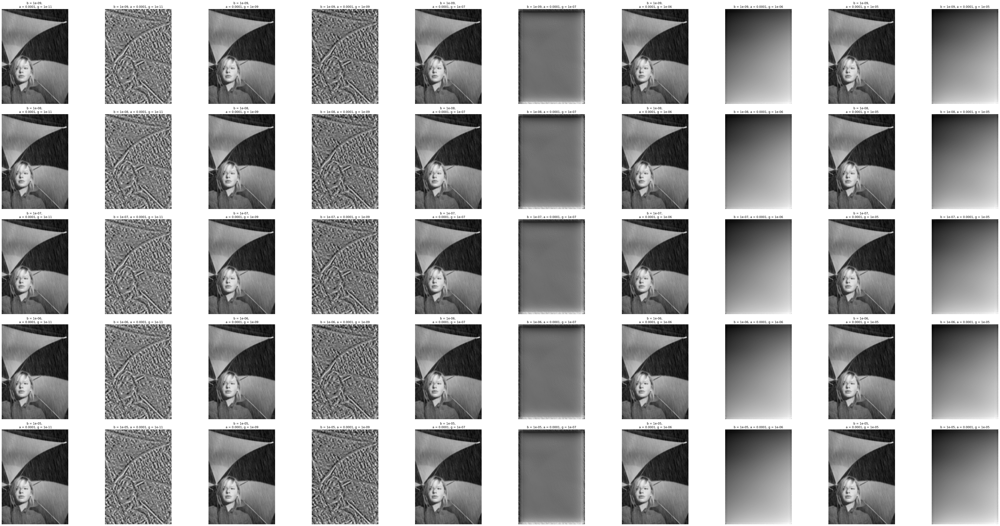

In [108]:
_, axs = plt.subplots(5,10, figsize = (60, 30))

i = -1
for b, a, g, B, R in pictures:
    if a == 1e-4:
        i += 1
        axs[i//5, i%5*2].imshow(B, cmap = "gray")
        axs[i//5, i%5*2 + 1].imshow(R, cmap = "gray")
        axs[i//5, i%5*2].axis("off")
        axs[i//5, i%5*2 + 1].axis("off")
        axs[i//5, i%5*2].set_title(f"b = {b}, \n a = {a}, g = {g}")
        axs[i//5, i%5*2 + 1].set_title(f"b = {b}, a = {a}, g = {g}") 

plt.tight_layout()   

### Second round

beta n'a toujours aucune influence sur les résultats

Pour gamma > 1e-8, gamma prend le dessus. Pour gamma < 1e-10, gamma n'a plus d'influence.


In [ ]:
beta_list = [1e-5, 1e-4, 1e-3]
alpha_list = [1e-6, 5*1e-6, 1e-5]
gamma_list = [1e-10, 1e-9, 1e-8]

test_list = [(b, a, g) for b in beta_list for a in alpha_list for g in gamma_list]
for b, a, g in tqdm(test_list):
    if not (b,a,g) in dico_pictures:
        B, R, gB, gR = opti(Y,
                        r_gmm = r_gmm, b_gmm = b_gmm,
                        alpha = a, beta = b, gamma = g, 
                        omega0 = 1,
                        max_iter = 5)
        dico_pictures[(b, a, g)] = B, R

100%|██████████| 27/27 [30:27<00:00, 67.69s/it]


In [118]:
for b, a, g, in dico_pictures:
    B, R = dico_pictures[(b, a, g)]
    np.save(f"tuning/B/{b}_{a}_{g}.npy", B)
    np.save(f"tuning/R/{b}_{a}_{g}.npy", R)

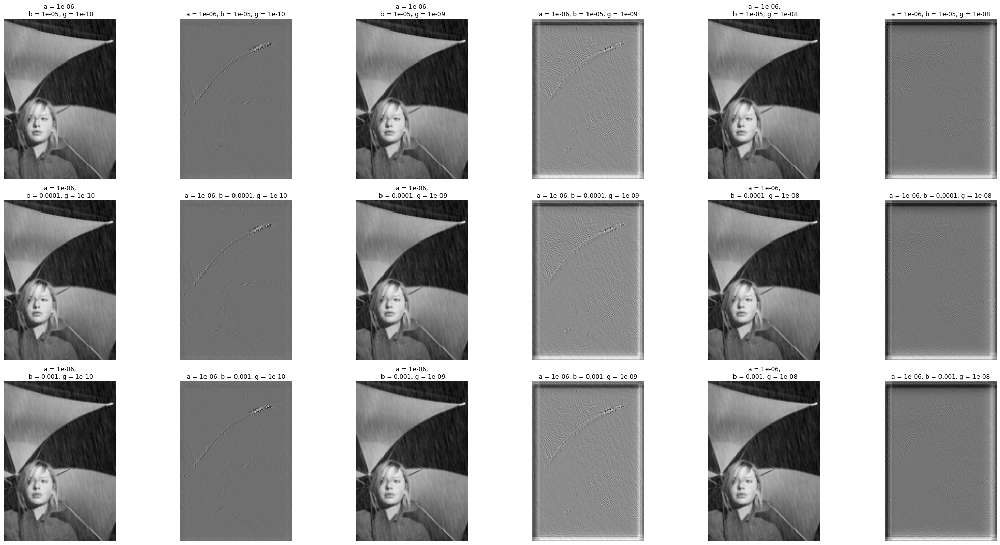

In [112]:
_, axs = plt.subplots(3, 6, figsize = (30, 15))
a= 1e-6
for i, (b, g) in enumerate([(b,g) for b in beta_list for g in gamma_list]):
    axs[i//3, i%3*2].imshow(dico_pictures[b, a, g][0], cmap = "gray")
    axs[i//3, i%3*2+1].imshow(dico_pictures[b, a, g][1], cmap = "gray")
    axs[i//3, i%3*2].axis("off")
    axs[i//3, i%3*2+1].axis("off")
    axs[i//3, i%3*2].set_title(f"a = {a},\n b = {b}, g = {g}")
    axs[i//3, i%3*2 + 1].set_title(f"a = {a}, b = {b}, g = {g}")

plt.tight_layout()
plt.show()

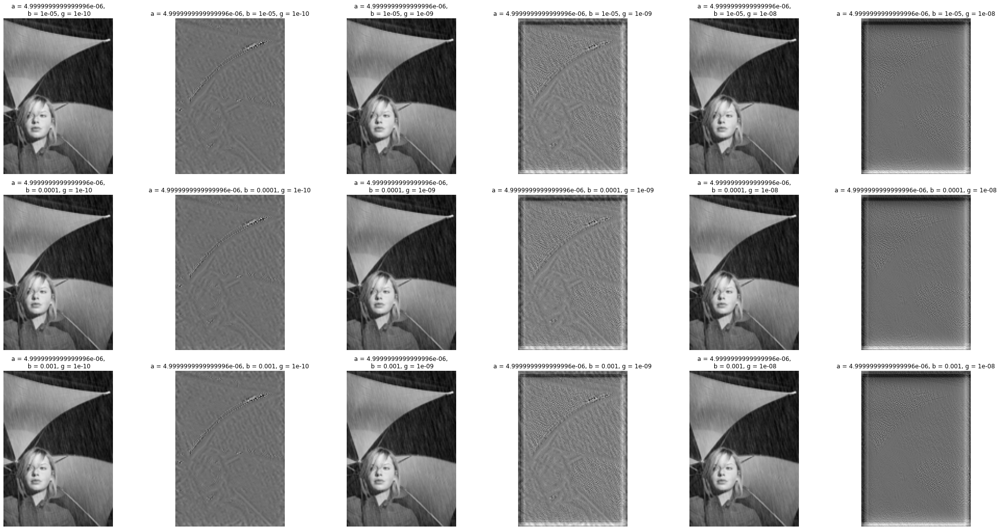

In [113]:
_, axs = plt.subplots(3, 6, figsize = (30, 15))
a= 5*1e-6
for i, (b, g) in enumerate([(b,g) for b in beta_list for g in gamma_list]):
    axs[i//3, i%3*2].imshow(dico_pictures[b, a, g][0], cmap = "gray")
    axs[i//3, i%3*2+1].imshow(dico_pictures[b, a, g][1], cmap = "gray")
    axs[i//3, i%3*2].axis("off")
    axs[i//3, i%3*2+1].axis("off")
    axs[i//3, i%3*2].set_title(f"a = {a},\n b = {b}, g = {g}")
    axs[i//3, i%3*2 + 1].set_title(f"a = {a}, b = {b}, g = {g}")

plt.tight_layout()
plt.show()

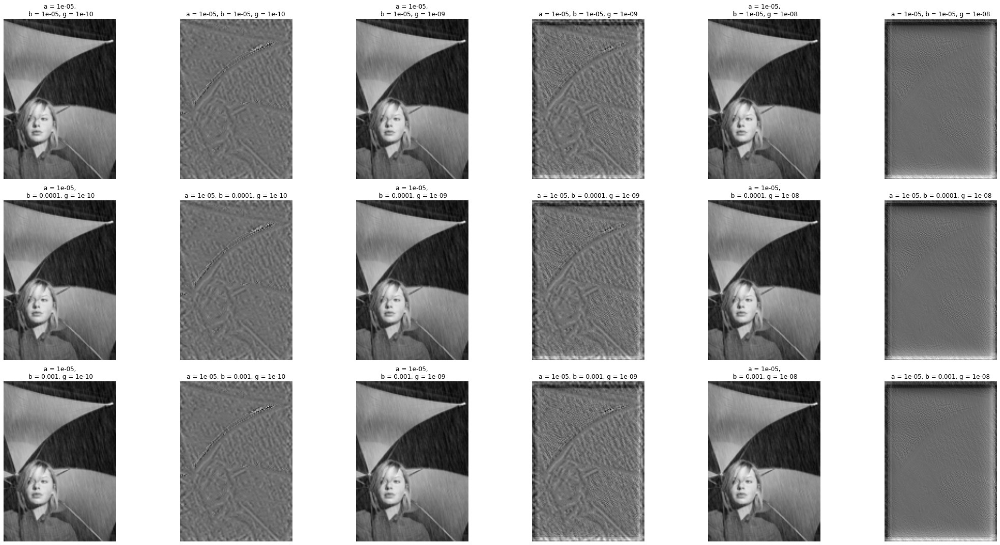

In [114]:
_, axs = plt.subplots(3, 6, figsize = (30, 15))
a= 1e-5
for i, (b, g) in enumerate([(b,g) for b in beta_list for g in gamma_list]):
    axs[i//3, i%3*2].imshow(dico_pictures[b, a, g][0], cmap = "gray")
    axs[i//3, i%3*2+1].imshow(dico_pictures[b, a, g][1], cmap = "gray")
    axs[i//3, i%3*2].axis("off")
    axs[i//3, i%3*2+1].axis("off")
    axs[i//3, i%3*2].set_title(f"a = {a},\n b = {b}, g = {g}")
    axs[i//3, i%3*2 + 1].set_title(f"a = {a}, b = {b}, g = {g}")

plt.tight_layout()
plt.show()

### Third round

In [122]:
beta_list = [1e-11, 1e-10, 1e-9]
alpha_list = [1e-6, 1e-5, 1e-4]
gamma_list = [1e-9, 1e-8, 1e-7]

test_list = [(b, a, g) for b in beta_list for a in alpha_list for g in gamma_list]
for b, a, g in tqdm(test_list):
    if not (b,a,g) in dico_pictures:
        B, R, gB, gR = opti(Y,
                        r_gmm = r_gmm, b_gmm = b_gmm,
                        alpha = a, beta = b, gamma = g, 
                        omega0 = 1,
                        max_iter = 5)
        dico_pictures[(b, a, g)] = B, R

100%|██████████| 27/27 [36:36<00:00, 81.36s/it]


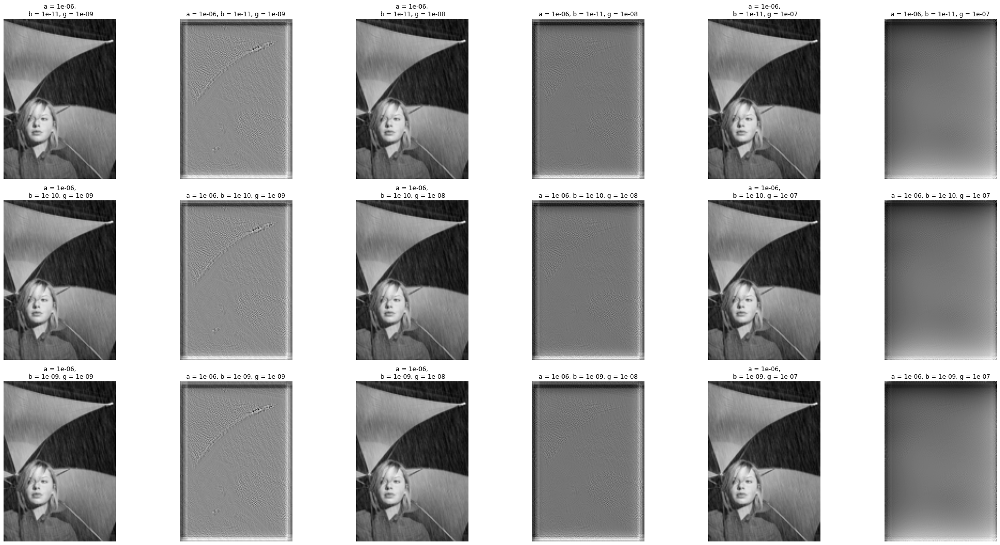

In [124]:
_, axs = plt.subplots(3, 6, figsize = (30, 15))
a= 1e-6
for i, (b, g) in enumerate([(b,g) for b in beta_list for g in gamma_list]):
    axs[i//3, i%3*2].imshow(dico_pictures[b, a, g][0], cmap = "gray")
    axs[i//3, i%3*2+1].imshow(dico_pictures[b, a, g][1], cmap = "gray")
    axs[i//3, i%3*2].axis("off")
    axs[i//3, i%3*2+1].axis("off")
    axs[i//3, i%3*2].set_title(f"a = {a},\n b = {b}, g = {g}")
    axs[i//3, i%3*2 + 1].set_title(f"a = {a}, b = {b}, g = {g}")

plt.tight_layout()
plt.show()

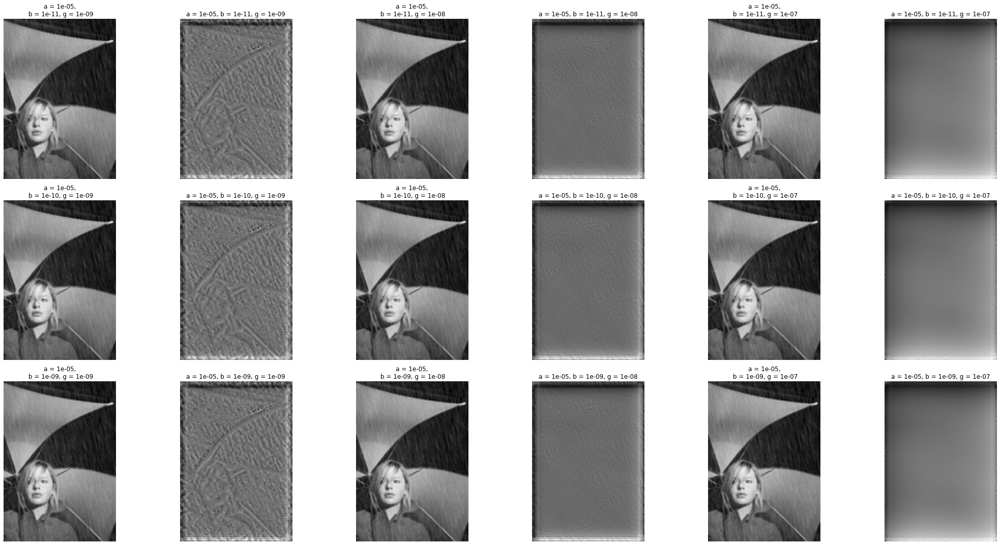

In [125]:
_, axs = plt.subplots(3, 6, figsize = (30, 15))
a= 1e-5
for i, (b, g) in enumerate([(b,g) for b in beta_list for g in gamma_list]):
    axs[i//3, i%3*2].imshow(dico_pictures[b, a, g][0], cmap = "gray")
    axs[i//3, i%3*2+1].imshow(dico_pictures[b, a, g][1], cmap = "gray")
    axs[i//3, i%3*2].axis("off")
    axs[i//3, i%3*2+1].axis("off")
    axs[i//3, i%3*2].set_title(f"a = {a},\n b = {b}, g = {g}")
    axs[i//3, i%3*2 + 1].set_title(f"a = {a}, b = {b}, g = {g}")

plt.tight_layout()
plt.show()

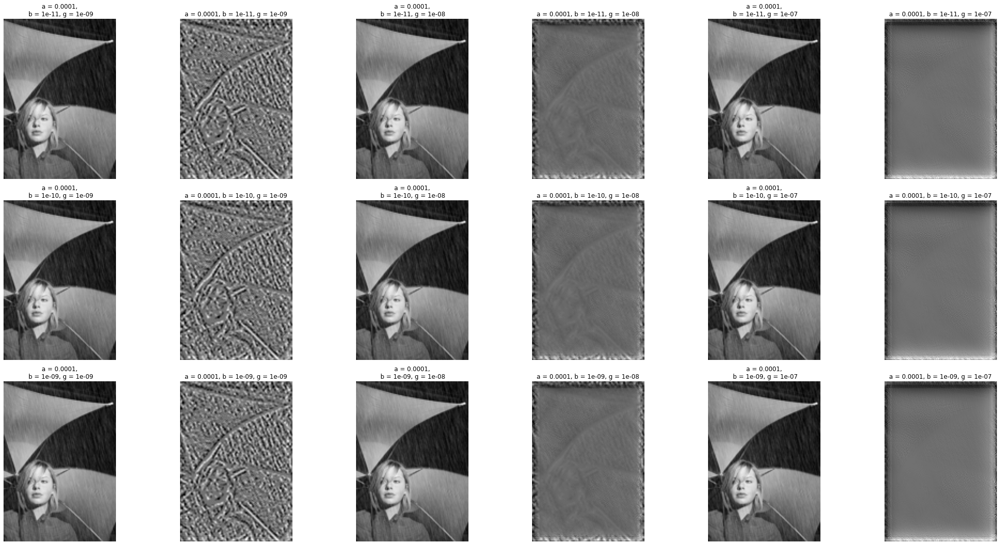

In [126]:
_, axs = plt.subplots(3, 6, figsize = (30, 15))
a= 1e-4
for i, (b, g) in enumerate([(b,g) for b in beta_list for g in gamma_list]):
    axs[i//3, i%3*2].imshow(dico_pictures[b, a, g][0], cmap = "gray")
    axs[i//3, i%3*2+1].imshow(dico_pictures[b, a, g][1], cmap = "gray")
    axs[i//3, i%3*2].axis("off")
    axs[i//3, i%3*2+1].axis("off")
    axs[i//3, i%3*2].set_title(f"a = {a},\n b = {b}, g = {g}")
    axs[i//3, i%3*2 + 1].set_title(f"a = {a}, b = {b}, g = {g}")

plt.tight_layout()
plt.show()

### Fourth round

In [ ]:
beta_list = [1e-2, 1e-1, 1e0]
alpha_list = [1e-7, 3*1e-6, 7*1e-6]
gamma_list = [5*1e-10, 1e-9, 5*1e-9]

test_list = [(b, a, g) for b in beta_list for a in alpha_list for g in gamma_list]
for b, a, g in tqdm(test_list):
    if not (b,a,g) in dico_pictures:
        B, R, gB, gR = opti(Y,
                        r_gmm = r_gmm, b_gmm = b_gmm,
                        alpha = a, beta = b, gamma = g, 
                        omega0 = 1,
                        max_iter = 5)
        dico_pictures[(b, a, g)] = B, R

100%|██████████| 27/27 [32:52<00:00, 73.05s/it]


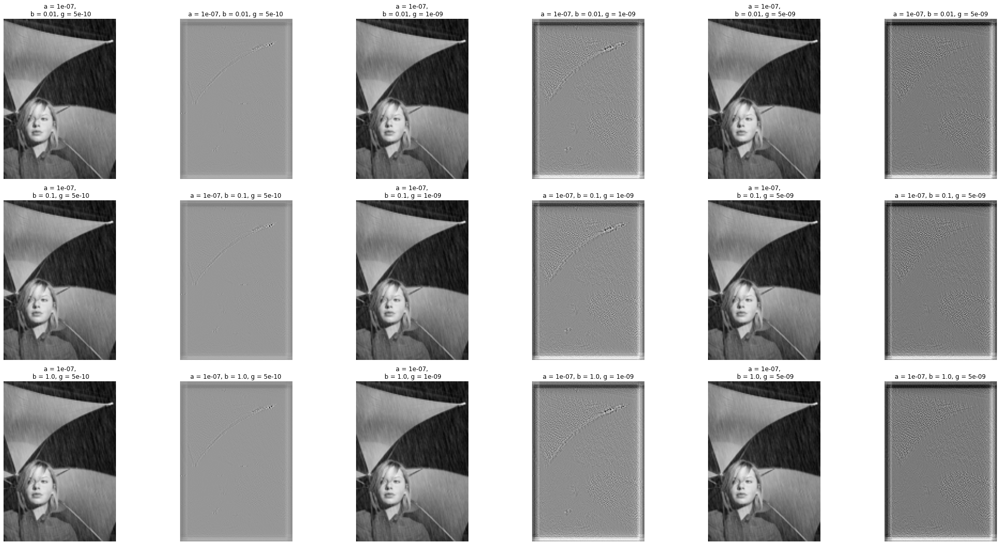

In [129]:
_, axs = plt.subplots(3, 6, figsize = (30, 15))
a= 1e-7
for i, (b, g) in enumerate([(b,g) for b in beta_list for g in gamma_list]):
    axs[i//3, i%3*2].imshow(dico_pictures[b, a, g][0], cmap = "gray")
    axs[i//3, i%3*2+1].imshow(dico_pictures[b, a, g][1], cmap = "gray")
    axs[i//3, i%3*2].axis("off")
    axs[i//3, i%3*2+1].axis("off")
    axs[i//3, i%3*2].set_title(f"a = {a},\n b = {b}, g = {g}")
    axs[i//3, i%3*2 + 1].set_title(f"a = {a}, b = {b}, g = {g}")

plt.tight_layout()
plt.show()

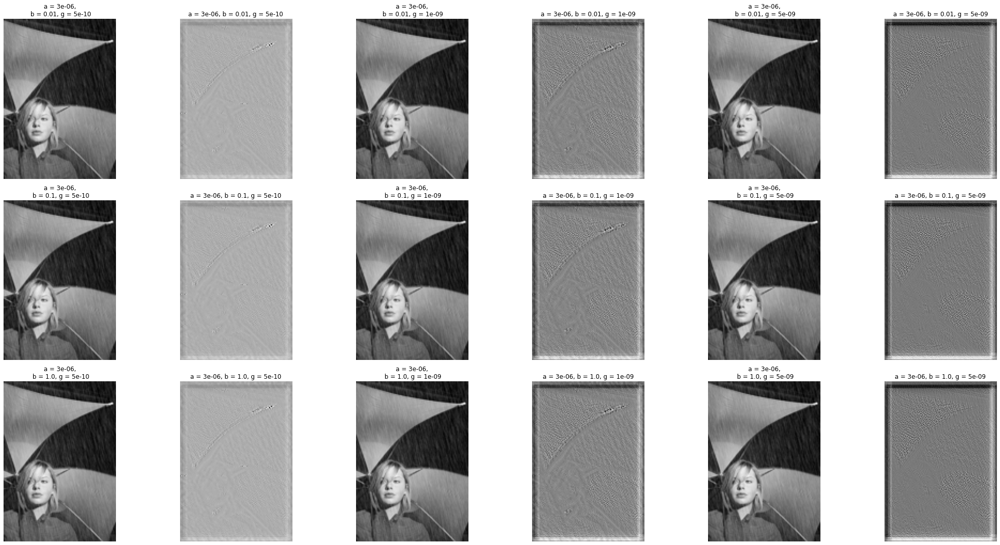

In [132]:
_, axs = plt.subplots(3, 6, figsize = (30, 15))
a= 3*1e-6
for i, (b, g) in enumerate([(b,g) for b in beta_list for g in gamma_list]):
    axs[i//3, i%3*2].imshow(dico_pictures[b, a, g][0], cmap = "gray")
    axs[i//3, i%3*2+1].imshow(dico_pictures[b, a, g][1], cmap = "gray")
    axs[i//3, i%3*2].axis("off")
    axs[i//3, i%3*2+1].axis("off")
    axs[i//3, i%3*2].set_title(f"a = {a},\n b = {b}, g = {g}")
    axs[i//3, i%3*2 + 1].set_title(f"a = {a}, b = {b}, g = {g}")

plt.tight_layout()
plt.show()

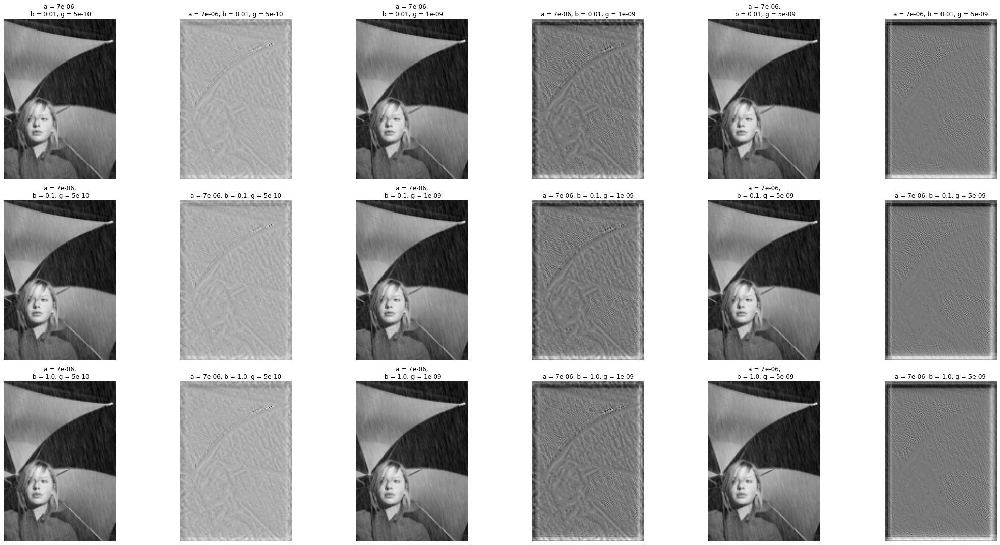

In [133]:
_, axs = plt.subplots(3, 6, figsize = (30, 15))
a= 7*1e-6
for i, (b, g) in enumerate([(b,g) for b in beta_list for g in gamma_list]):
    axs[i//3, i%3*2].imshow(dico_pictures[b, a, g][0], cmap = "gray")
    axs[i//3, i%3*2+1].imshow(dico_pictures[b, a, g][1], cmap = "gray")
    axs[i//3, i%3*2].axis("off")
    axs[i//3, i%3*2+1].axis("off")
    axs[i//3, i%3*2].set_title(f"a = {a},\n b = {b}, g = {g}")
    axs[i//3, i%3*2 + 1].set_title(f"a = {a}, b = {b}, g = {g}")

plt.tight_layout()
plt.show()

# Best hyperparameters

In [ ]:
B, R, gB, gR = tools_opti.opti(Y,
                r_gmm = r_gmm, b_gmm = b_gmm,
                alpha = 1e-7, beta = 1e-4, gamma = 1e-9, 
                omega0 = 1,
                max_iter = 20)

100%|██████████| 20/20 [11:30<00:00, 34.51s/it]


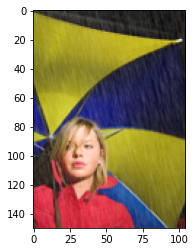

In [ ]:
plt.imshow(tools_preprocess_image.to_RGB(255*B, Cr, Cb))